In [5]:
import numpy as np
import pandas as pd
import emcee
import corner
from scipy.optimize import minimize

%matplotlib notebook
import matplotlib.pyplot as plt

In [3]:
sn = 'ZTF18aaxsioa'
lc_df = pd.read_csv("../Marshall_data/growth_marshall_lcs/forced_lightcurves/{}.csv".format(sn))
salt_df = pd.read_csv("../Marshall_data/growth_marshall_lcs/MB_SALT_020419.csv")

<IPython.core.display.Javascript object>


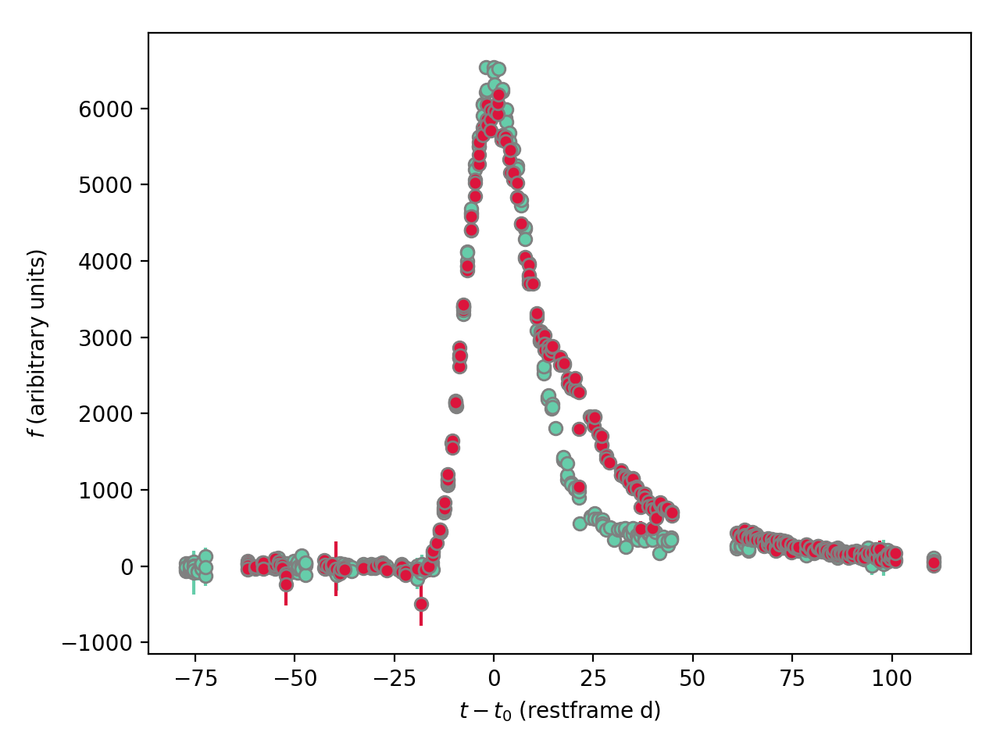

In [135]:
g_obs = np.where((lc_df['programid'] == 2.0) & 
                 (lc_df['nbaseline'] > 30) & 
                 (lc_df['filter'] == 'g'))
r_obs = np.where((lc_df['programid'] == 2.0) & 
                 (lc_df['nbaseline'] > 30) & 
                 (lc_df['filter'] == 'r'))
obs = np.where((lc_df['programid'] == 2.0) & 
               (lc_df['nbaseline'] > 30))

t0 = float(salt_df['t0'][salt_df['sn'] == sn].values) + 2400000.5
z = float(salt_df['z'][salt_df['sn'] == sn].values)

fig, ax = plt.subplots()
ax.errorbar((lc_df['jdobs'].iloc[g_obs] - t0)/(1+z), 
            lc_df['Fpsf'].iloc[g_obs],
            lc_df['eFpsf'].iloc[g_obs], 
            fmt = 'o', color='MediumAquaMarine',
            mec='0.5')
ax.errorbar((lc_df['jdobs'].iloc[r_obs] - t0)/(1+z), 
            lc_df['Fpsf'].iloc[r_obs],
            lc_df['eFpsf'].iloc[r_obs], 
            fmt = 'o', color='Crimson',
            mec='0.5')
ax.set_xlabel('$t - t_0 \; (\mathrm{restframe \; d})$')
ax.set_ylabel('$f \; (\mathrm{aribitrary \; units})$')
fig.tight_layout()

In [7]:
def calc_t_p(t_b, alpha_d, alpha_r, s):
    return t_b*(-1/(1 - 2*alpha_d/alpha_r))**(1/(s*alpha_d))

In [8]:
def f_t(times, amplitude=25, t_b=20, t_0=0, alpha_r=2, alpha_d=2, s=2):
    time_term = (times - t_0)/t_b
    
    return amplitude * (time_term)**alpha_r * (1 + (time_term)**(s*alpha_d))**(-2/s)

## Setup emcee to run MCMC

In [183]:
def lnlikelihood(theta, f, t, f_err):
    t_0, a, a_prime, t_b, alpha_r, alpha_d, s, sig_0 = theta

    pre_exp = np.logical_not(t > t_0)
    model = np.empty_like(f)
    model[pre_exp] = a
    
    time_term = (t[~pre_exp] - t_0)/t_b
    model[~pre_exp] = a + a_prime * (time_term)**alpha_r * (1 + (time_term)**(s*alpha_d))**(-2/s)
    
    ln_l = np.sum(np.log(1. / np.sqrt(2*np.pi * (sig_0**2 + f_err**2))) - ((f - model)**2 / (2 * (sig_0**2 + f_err**2))))
    return ln_l

def lnlikelihood_no_sig0(theta, f, t, f_err):
    t_0, a, a_prime, t_b, alpha_r, alpha_d, s = theta

    pre_exp = np.logical_not(t > t_0)
    model = np.empty_like(f)
    model[pre_exp] = a
    
    time_term = (t[~pre_exp] - t_0)/t_b
    model[~pre_exp] = a + a_prime * (time_term)**alpha_r * (1 + (time_term)**(s*alpha_d))**(-2/s)
    
#     ln_l = np.sum(np.log(1. / np.sqrt(2*np.pi * (f_err**2))) - ((f - model)**2 / (2 * (f_err**2))))
    ln_l = -1/2*np.sum(((f - model)/f_err)**2) + np.sum(np.log(1/np.sqrt(2*np.pi*f_err**2)))
    
#     print(-1/2*np.sum(((f_data - model)/f_unc_data)**2) + np.sum(np.log(1/np.sqrt(2*np.pi*f_unc_data**2))))
    
    return ln_l


def nll(theta, f, t, f_err):
    return -1*lnlikelihood_no_sig0(theta, f, t, f_err)

#Define priors on parameters  
def lnprior(theta):
    t_0, a, a_prime, t_b, alpha_r, alpha_d, s, sig_0 = theta
    if (-1e8 < t_0 < 1e8 and 0 < alpha_r < 1e8 and 
        0 < alpha_d < 1e8 and 0 < sig_0 < 1e8 and 
        -1e8 < a < 1e8 and  0 < t_b < 1e8 and 
        0 < s < 1e8 and 0 < a_prime < 1e8):
        return 0.0
    return -np.inf

def lnposterior(theta, f, t, f_err):
    lnp = lnprior(theta)
    lnl = lnlikelihood(theta, f, t, f_err)
    if not np.isfinite(lnl):
        return -np.inf
    if not np.isfinite(lnp):
        return -np.inf
    return lnl + lnp

In [105]:
time = (lc_df['jdobs'].iloc[g_obs].values - t0)/(1+z)
flux = lc_df['Fpsf'].iloc[g_obs].values
flux_unc = lc_df['eFpsf'].iloc[g_obs].values

t_fl = 18

guess_0 = [0, 2*np.max(flux), -t_fl, 18, 2, 2, 2]
nll(guess_0, flux, time - t_fl, flux_unc)

pre_sec_peak = np.where(time <= 7)
f_data = flux[pre_sec_peak]
t_data = time[pre_sec_peak]
f_unc_data = flux_unc[pre_sec_peak]

In [106]:
# initialize near maximum-likelihood result
ml_res = minimize(nll, guess_0, method='Powell', # Powell method does not need derivatives
                  args=(f_data, t_data, f_unc_data))
ml_guess = ml_res.x
print(ml_guess)
if ml_guess[-1] < 0:
    ml_guess[-1] *= -1
ml_guess[2] += t_fl
print(nll(ml_guess, f_data, t_data+t_fl, f_unc_data))

[-2.77088909e+00  1.25203123e+04 -1.71709158e+01  1.66285632e+01
  2.23213612e+00  2.17900051e+00  2.07519401e+00]
914.9616630914643


<IPython.core.display.Javascript object>


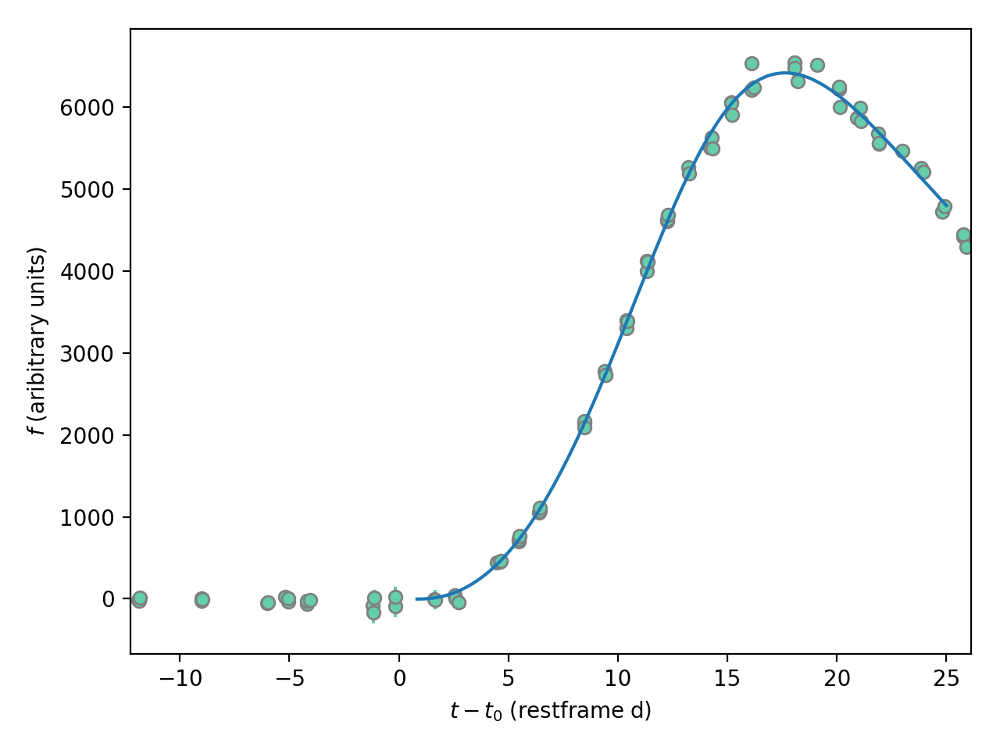

In [109]:
t_grid = np.linspace(ml_guess[2], 7+t_fl, 1000)
model_flux = ml_guess[0] + f_t(t_grid, ml_guess[1], ml_guess[3], ml_guess[2],
                               ml_guess[4], ml_guess[5], ml_guess[6])
fig, ax = plt.subplots()
ax.errorbar((lc_df['jdobs'].iloc[g_obs] - t0)/(1+z) + t_fl, 
            lc_df['Fpsf'].iloc[g_obs],
            lc_df['eFpsf'].iloc[g_obs], 
            fmt = 'o', color='MediumAquaMarine',
            mec='0.5')
ax.plot(t_grid, model_flux, zorder=10)
ax.set_xlabel('$t - t_0 \; (\mathrm{restframe \; d})$')
ax.set_ylabel('$f \; (\mathrm{aribitrary \; units})$')
fig.tight_layout()

In [110]:
#number of walkers
nwalkers = 500
nfac = [5e-3, 5e-3, 5e-3, 5e-3, 5e-3, 5e-3, 5e-3, 5e-3]
ndim = len(ml_guess) + 1

#initial position of walkers
pos = [np.append(ml_guess, 1) + nfac * np.random.randn(ndim) for i in range(nwalkers)]

#run initial burn-in
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnposterior, args=(f_data, t_data + t_fl, f_unc_data))
max_samples = 15000

index = 0
autocorr = np.empty(max_samples)
old_tau = np.inf
check_tau = 50000
for sample in sampler.sample(pos, iterations=max_samples, progress=True):
    if sampler.iteration % check_tau:
        continue
    tau = sampler.get_autocorr_time(tol=0)
    autocorr[index] = np.mean(tau)
    index += 1

    # Check convergence
    converged = np.all(tau * 100 < sampler.iteration)
    converged &= np.all(np.abs(old_tau - tau) / tau < 0.01)
    if converged:
        break
    old_tau = tau

 13%|█▎        | 1960/15000 [00:51<05:32, 39.20it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in square
  # This is added back by InteractiveShellApp.init_path()
 30%|███       | 4515/15000 [01:57<04:33, 38.37it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in power
  if __name__ == '__main__':
 90%|████████▉ | 13465/15000 [05:51<00:39, 38.42it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in multiply
  if __name__ == '__main__':
100%|██████████| 15000/15000 [06:32<00:00, 38.26it/s]


In [111]:
# np.argmax(sampler.lnprobability[-1,:])
nll(sampler.chain[np.argmax(sampler.lnprobability[-1,:]), -1, :-1], 
    f_data, t_data + t_fl, f_unc_data)

914.5896018739957

In [112]:
sampler.chain[np.argmax(sampler.lnprobability[-1,:]), -1, :-1]

array([-3.11877987e+00,  1.29768886e+04,  1.36778307e+00,  1.67761984e+01,
        2.05116577e+00,  2.17486873e+00,  1.96851567e+00])

In [113]:
sampler.lnprobability[-1,:]

array([-917.80300681, -916.19052426, -916.08929275, -920.72553541,
       -916.57948732, -918.4499872 , -915.63907874, -917.71956368,
       -917.29267202, -916.8481657 , -917.57823107, -919.88945976,
       -919.06031781, -917.10655253, -920.83893038, -918.18897972,
       -916.9347318 , -920.99034692, -918.04798501, -916.74833369,
       -919.38555583, -920.40180794, -918.31581165, -919.11875255,
       -917.08332076, -919.82790184, -918.72517313, -916.88314117,
       -918.86239657, -916.63394213, -921.70699591, -915.15949898,
       -921.57788633, -919.25349232, -920.66189548, -916.20819409,
       -918.86507773, -916.12332751, -918.48474353, -916.33111981,
       -918.88837202, -916.67974259, -919.5498929 , -918.80257774,
       -917.32520672, -920.77773704, -917.80548707, -918.81682076,
       -919.24091399, -917.31901507, -916.8996186 , -917.17557351,
       -917.68078654, -918.3037054 , -916.27945006, -918.89568963,
       -914.80112032, -917.91190835, -915.71139832, -917.56924

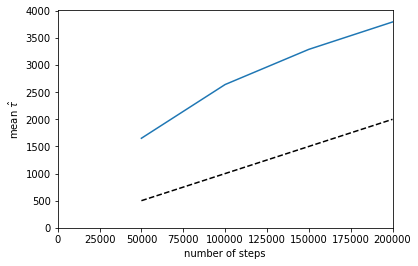

In [10]:
n = check_tau*np.arange(1, index+1)
y = autocorr[:index]
plt.plot(n, n / 100.0, "--k")
plt.plot(n, y)
plt.xlim(0, n.max())
plt.ylim(0, y.max() + 0.1*(y.max() - y.min()))
plt.xlabel("number of steps")
plt.ylabel(r"mean $\hat{\tau}$");

<IPython.core.display.Javascript object>


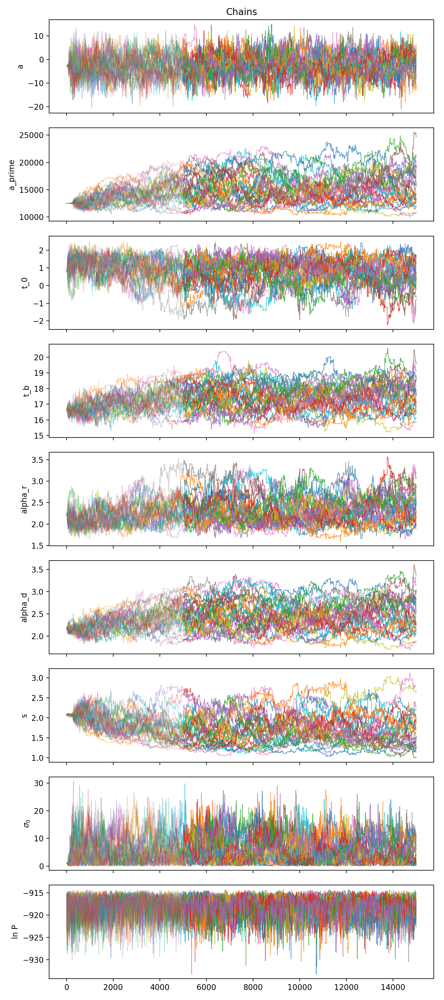

In [114]:
nburn = 5000
ax = plotChains(sampler, nburn, paramsNames, nplot=25)
plt.show()
plt.tight_layout()

<IPython.core.display.Javascript object>


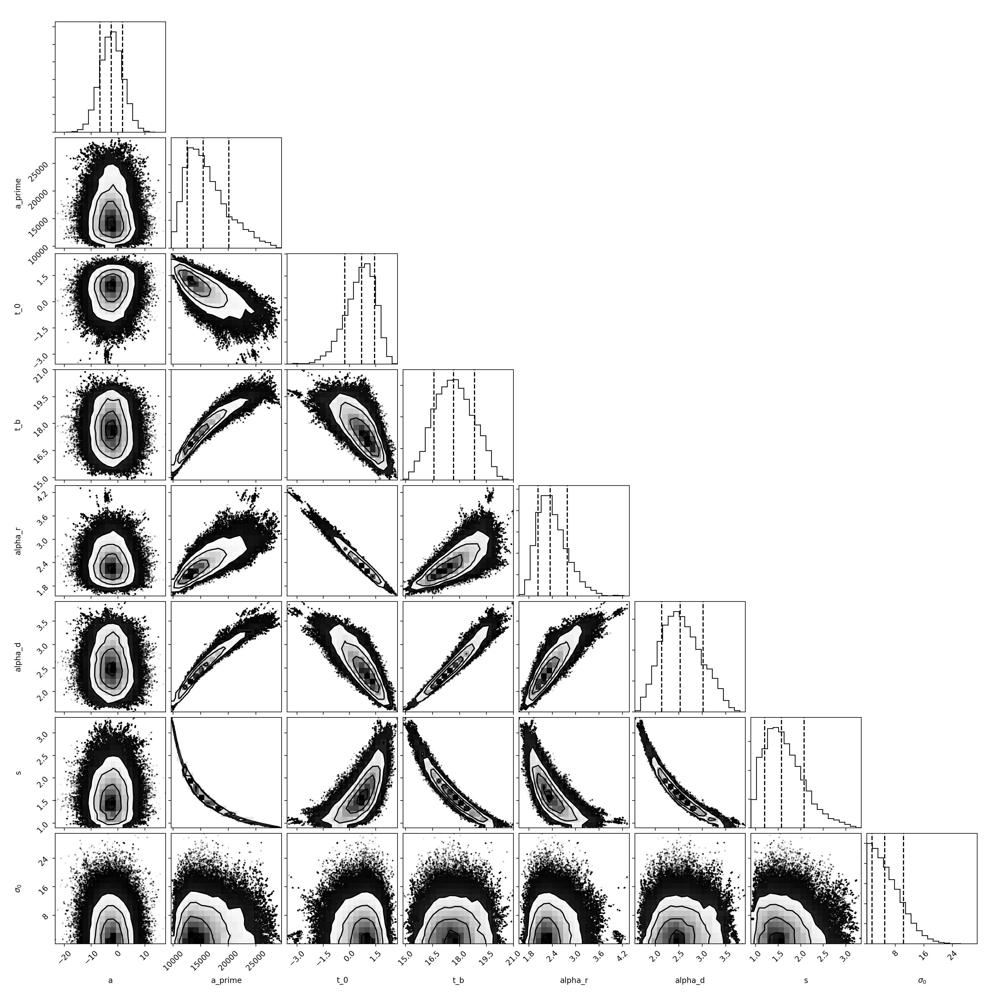

In [115]:
nburn = 12000
makeCorner(sampler, nburn, paramsNames)
plt.show()

<IPython.core.display.Javascript object>


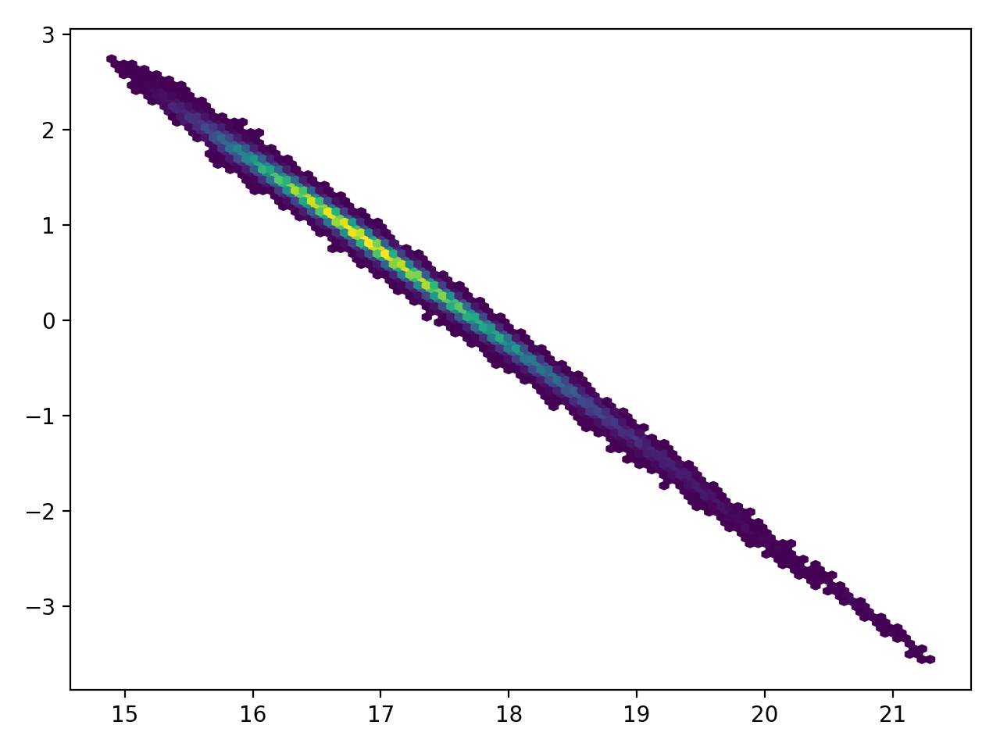

In [116]:
burnin = 10000
t_p = calc_t_p(sampler.get_chain(discard = burnin, flat=True)[:,3], 
         sampler.get_chain(discard = burnin, flat=True)[:,5], 
         sampler.get_chain(discard = burnin, flat=True)[:,4], 
         sampler.get_chain(discard = burnin, flat=True)[:,6])

plt.figure()
plt.hexbin(t_p, sampler.get_chain(discard = burnin, flat=True)[:,2], mincnt=1)
plt.tight_layout()

<IPython.core.display.Javascript object>


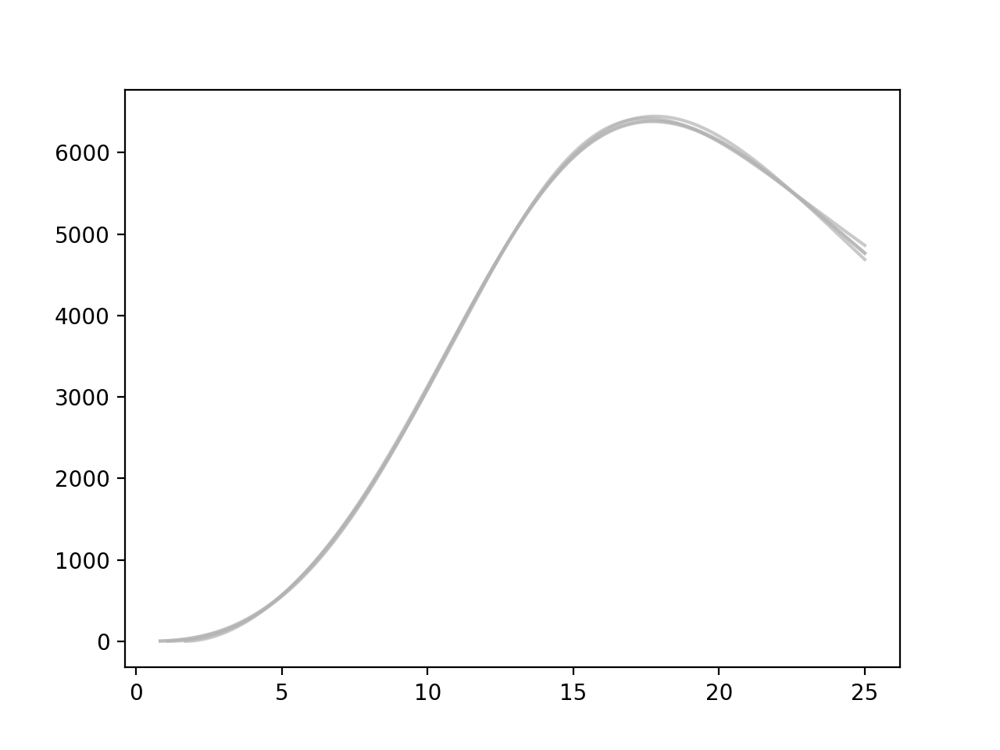

68
[-1.19289683e+00  1.64641729e+04  1.07275193e+00  1.83658595e+01
  2.18436689e+00  2.65758111e+00  1.44456127e+00  1.11891785e+00]
290
[1.17912310e+00 9.83260622e+03 1.69144004e+00 1.52495108e+01
 1.86994917e+00 1.69688664e+00 3.22982523e+00 1.78252303e+01]
166
[-2.33005279e+00  1.55706311e+04  2.41361506e-01  1.76351533e+01
  2.52630887e+00  2.57393869e+00  1.55690464e+00  6.63092617e+00]
200
[3.92132447e+00 1.57277010e+04 3.24600293e-01 1.75645873e+01
 2.52694808e+00 2.57815157e+00 1.53651878e+00 7.98536021e-01]


/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in power
  after removing the cwd from sys.path.


In [118]:
plt.figure()
for samp_num in np.random.randint(0, len(sampler.chain[:,-1,:]), size=4):
    print(samp_num)
    sample = sampler.chain[:,-1,:][samp_num]
    print(sample)
    flux_fit = f_t(t_grid, amplitude=sample[1], t_0=sample[2], t_b=sample[3], 
                        alpha_r=sample[4], alpha_d=sample[5], s=sample[6])
    plt.plot(t_grid, flux_fit, "0.7", alpha=0.7)

### Try multi-filter solution

In [184]:
def multifilter_lnlikelihood(theta, f, t, f_err, filt_arr):
    
    if len(theta) % 7 != 1:
        raise RuntimeError('The correct number of parameters were not included')
    
    ln_l = 0
    for filt_num, filt in enumerate(np.unique(filt_arr)):
        theta_filt = np.append(theta[0], theta[1+7*filt_num:8+7*filt_num])
        filt_obs = np.where(filt_arr == filt)
        f_filt = f[filt_obs]
        t_filt = t[filt_obs]
        f_err_filt = f_err[filt_obs]
        ln_l += lnlikelihood(theta_filt, f_filt, t_filt, f_err_filt)
    
    return ln_l

def multifilter_lnlikelihood_no_sig0(theta, f, t, f_err, filt_arr):
    
    if len(theta) % 7 != 1:
        raise RuntimeError('The correct number of parameters were not included')
    
    ln_l = 0
    for filt_num, filt in enumerate(np.unique(filt_arr)):
        theta_filt = np.append(theta[0], theta[1+7*filt_num:7+7*filt_num])
        filt_obs = np.where(filt_arr == filt)
        f_filt = f[filt_obs]
        t_filt = t[filt_obs]
        f_err_filt = f_err[filt_obs]
        ln_l += lnlikelihood_no_sig0(theta_filt, f_filt, t_filt, f_err_filt)
    return ln_l

def multifilter_nll(theta, f, t, f_err, filt_arr):
    return -1*multifilter_lnlikelihood_no_sig0(theta, f, t, f_err, filt_arr)

def multifilter_prior(theta, filt_arr):
    
    if len(theta) % 7 != 1:
        raise RuntimeError('The correct number of parameters were not included')
    
    ln_p = 0
    for filt_num, filt in enumerate(np.unique(filt_arr)):
        theta_filt = np.append(theta[0], theta[1+7*filt_num:8+7*filt_num])
        ln_p += lnprior(theta_filt)
    return ln_p

def multifilter_lnposterior(theta, f, t, f_err, filt_arr):
    lnp = multifilter_prior(theta, filt_arr)
    lnl = multifilter_lnlikelihood(theta, f, t, f_err, filt_arr)
    if not np.isfinite(lnl):
        return -np.inf
    if not np.isfinite(lnp):
        return -np.inf
    return lnl + lnp

In [185]:
time = (lc_df['jdobs'].iloc[obs].values - t0)/(1+z)
flux = lc_df['Fpsf'].iloc[obs].values
flux_unc = lc_df['eFpsf'].iloc[obs].values
filt_arr = lc_df['filter'].iloc[obs].values

t_fl = 18

guess_0 = [-t_fl, 
           0, 2*np.max(flux[filt_arr == 'g']), 18, 2, 2, 2, 1,
           0, 2*np.max(flux[filt_arr == 'r']), 18, 2, 2, 2, 1
          ]

print(multifilter_nll(guess_0, flux, time, flux_unc, filt_arr))

pre_sec_peak = np.where(time <= 7)
f_data = flux[pre_sec_peak]
t_data = time[pre_sec_peak]
f_unc_data = flux_unc[pre_sec_peak]
filt_data = filt_arr[pre_sec_peak]

49260.32204151156


In [186]:
# initialize near maximum-likelihood result
ml_res = minimize(multifilter_nll, guess_0, method='Powell', # Powell method does not need derivatives
                  args=(f_data, t_data, f_unc_data, filt_data))
ml_guess = ml_res.x
print(ml_guess)

# sig_0 is meaningless from the ML result
ml_guess[7::7] = 3

ml_guess[0] += t_fl
print(multifilter_nll(ml_guess, f_data, t_data+t_fl, f_unc_data, filt_data))

[-1.70259196e+01 -2.72052704e+00  1.28849000e+04  1.67539492e+01
  2.18972927e+00  2.20736273e+00  1.99143466e+00  1.21967827e+02
 -3.49084171e-01  1.21031691e+04  1.64572665e+01  2.12749200e+00
  2.09199720e+00  1.96203541e+00  1.21967827e+02]
1652.2027312833052


In [187]:
#number of walkers
nwalkers = 500
nfac = np.ones_like(ml_guess)*5e-3
ndim = len(ml_guess) 

#initial position of walkers
pos = [ml_guess + nfac * np.random.randn(ndim) for i in range(nwalkers)]

#run initial burn-in
sampler = emcee.EnsembleSampler(nwalkers, ndim, multifilter_lnposterior, args=(f_data, t_data + t_fl, f_unc_data, filt_data))
max_samples = 15000

index = 0
autocorr = np.empty(max_samples)
old_tau = np.inf
check_tau = 50000
for sample in sampler.sample(pos, iterations=max_samples, progress=True):
    if sampler.iteration % check_tau:
        continue
    tau = sampler.get_autocorr_time(tol=0)
    autocorr[index] = np.mean(tau)
    index += 1

    # Check convergence
    converged = np.all(tau * 100 < sampler.iteration)
    converged &= np.all(np.abs(old_tau - tau) / tau < 0.01)
    if converged:
        break
    old_tau = tau

 58%|█████▊    | 8753/15000 [23:12<15:36,  6.67it/s]  /Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in power
  if __name__ == '__main__':
 72%|███████▏  | 10728/15000 [28:39<10:22,  6.86it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in square
  # This is added back by InteractiveShellApp.init_path()
100%|██████████| 15000/15000 [40:25<00:00,  6.00it/s]


<IPython.core.display.Javascript object>


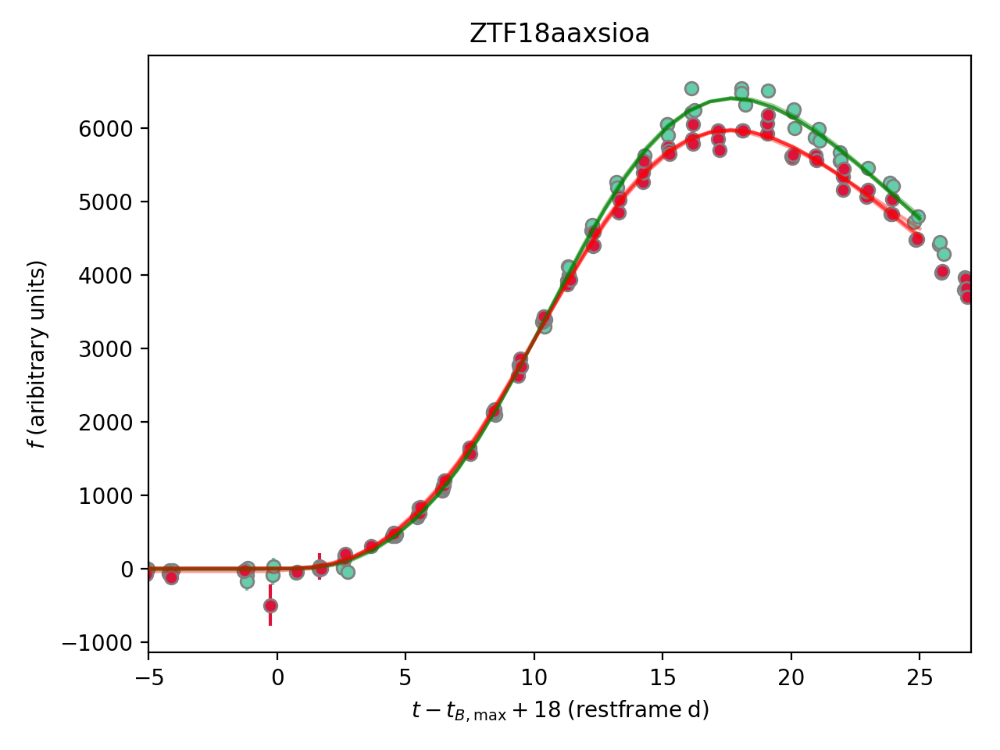

In [216]:
t_grid = np.linspace(-15, 25)

fig, ax = plt.subplots()
for filt_obs, color in zip([g_obs, r_obs], 
                           ['MediumAquaMarine', 'Crimson']):
    ax.errorbar((lc_df['jdobs'].iloc[filt_obs] - t0)/(1+z) + t_fl, 
                lc_df['Fpsf'].iloc[filt_obs],
                lc_df['eFpsf'].iloc[filt_obs], 
                fmt = 'o', color=color,
                mec='0.5')

ax.set_xlabel('$t - t_{B,\mathrm{max}} + 18 \; (\mathrm{restframe \; d})$')
ax.set_ylabel('$f \; (\mathrm{aribitrary \; units})$')


for samp_num in np.random.randint(0, len(sampler.chain[:,-1,:]), size=4):
#     print(samp_num)
    sample = sampler.chain[:,-1,:][samp_num]
#     print(sample)
    g_fit = np.ones_like(t_grid)*sample[1]
    r_fit = np.ones_like(t_grid)*sample[8]
    post_exp = np.where(t_grid > sample[0])
    g_fit[post_exp] = f_t(t_grid[post_exp], amplitude=sample[2], t_0=sample[0], t_b=sample[3], 
                        alpha_r=sample[4], alpha_d=sample[5], s=sample[6])
    ax.plot(t_grid, sample[1] + g_fit, "0.7", alpha=0.4, c='g', zorder=10)
    r_fit[post_exp] = f_t(t_grid[post_exp], amplitude=sample[9], t_0=sample[0], t_b=sample[10], 
                        alpha_r=sample[11], alpha_d=sample[12], s=sample[13])
    ax.plot(t_grid, sample[8] + r_fit, "0.7", alpha=0.4, c='r', zorder=10)
ax.set_xlim(-5,27)
ax.set_title('{}'.format(sn))
fig.tight_layout()


<IPython.core.display.Javascript object>


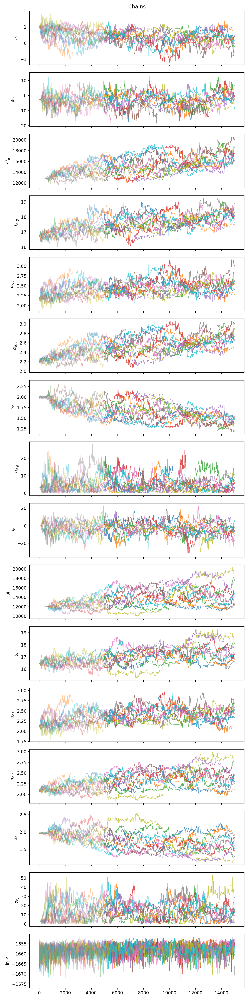

In [209]:
nburn = 5000
ax = plotChains(sampler, nburn, paramsNames, nplot=10)
plt.show()
plt.tight_layout()

<IPython.core.display.Javascript object>


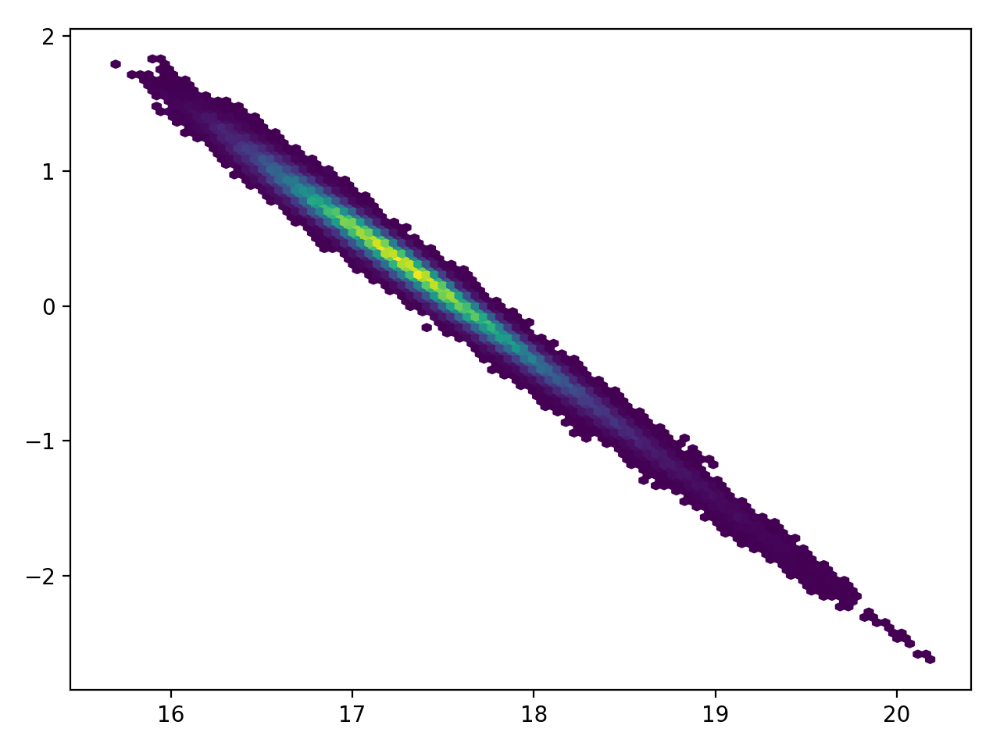

In [213]:
burnin = 5000
t_p_g = calc_t_p(sampler.get_chain(discard = burnin, flat=True)[:,3], 
         sampler.get_chain(discard = burnin, flat=True)[:,5], 
         sampler.get_chain(discard = burnin, flat=True)[:,4], 
         sampler.get_chain(discard = burnin, flat=True)[:,6])

t_p_r = calc_t_p(sampler.get_chain(discard = burnin, flat=True)[:,10], 
         sampler.get_chain(discard = burnin, flat=True)[:,12], 
         sampler.get_chain(discard = burnin, flat=True)[:,11], 
         sampler.get_chain(discard = burnin, flat=True)[:,13])

plt.figure()
plt.hexbin(t_p_r, sampler.get_chain(discard = burnin, flat=True)[:,0], mincnt=1)
plt.tight_layout()

<IPython.core.display.Javascript object>


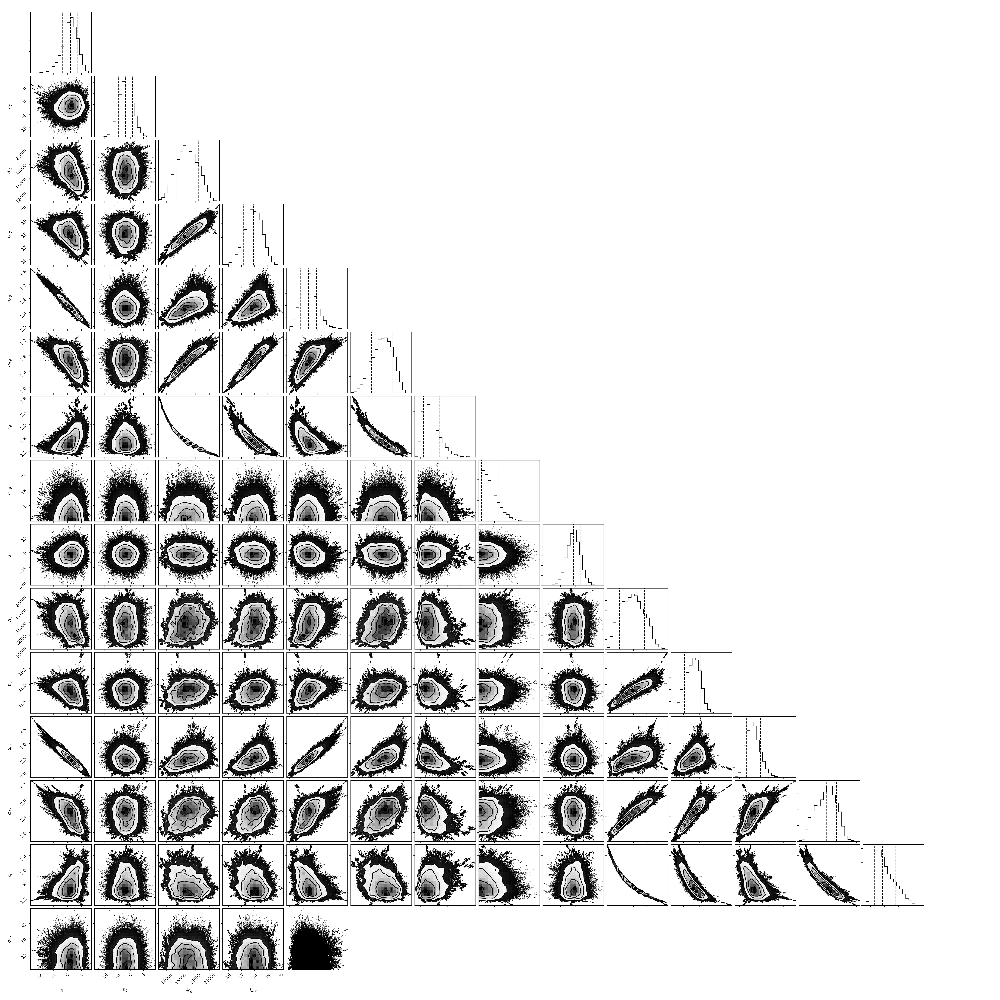

In [217]:
nburn = 12000
makeCorner(sampler, nburn, paramsNames)
plt.show()

In [218]:
from multiprocessing import Pool

In [223]:
#number of walkers
nwalkers = 500
nfac = np.ones_like(ml_guess)*5e-3
ndim = len(ml_guess) 

#initial position of walkers
pos = [ml_guess + nfac * np.random.randn(ndim) for i in range(nwalkers)]


with Pool() as pool:
#run initial burn-in
    sampler = emcee.EnsembleSampler(nwalkers, ndim, multifilter_lnposterior, 
                                    args=(f_data, t_data + t_fl, f_unc_data, filt_data),
                                    pool=pool)
    max_samples = 200000

    index = 0
    autocorr = np.empty(max_samples)
    old_tau = np.inf
    check_tau = 50000
    for sample in sampler.sample(pos, iterations=max_samples, progress=True):
        if sampler.iteration % check_tau:
            continue
        tau = sampler.get_autocorr_time(tol=0)
        autocorr[index] = np.mean(tau)
        index += 1

        # Check convergence
        converged = np.all(tau * 100 < sampler.iteration)
        converged &= np.all(np.abs(old_tau - tau) / tau < 0.01)
        if converged:
            break
        old_tau = tau

  6%|▌         | 11885/200000 [09:33<2:30:53, 20.78it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in square
  # This is added back by InteractiveShellApp.init_path()
  7%|▋         | 13347/200000 [10:43<2:25:57, 21.31it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: overflow encountered in power
  if __name__ == '__main__':
  7%|▋         | 14210/200000 [11:24<2:31:03, 20.50it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in square
  # This is added back by InteractiveShellApp.init_path()
  8%|▊         | 15086/200000 [12:06<2:31:07, 20.39it/s]/Users/adamamiller/miniconda3/envs/emcee3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: overflow encountered in square
  # This is added back by InteractiveShellApp.init_path()
  8

In [220]:
from multiprocessing import cpu_count
ncpu = cpu_count()
print("{0} CPUs".format(ncpu))

8 CPUs


In [224]:
tau = sampler.get_autocorr_time(tol=0)

In [225]:
tau

array([16777.18205969,  4762.53798914, 19088.37715163, 18777.67875597,
       17973.56115929, 19722.00957457, 19052.86915942,  5028.6055292 ,
        4673.1835954 , 19134.02534801, 18557.11292111, 18184.79636446,
       19997.94456583, 19260.83619279,  4926.11329957])

In [ ]:
tau

In [ ]:
2+2 

In [ ]:
n = check_tau*np.arange(1, index+1)
y = autocorr[:index]
plt.figure()
plt.plot(n, n / 100.0, "--k")
plt.plot(n, y)
plt.xlim(0, n.max())
plt.ylim(0, y.max() + 0.1*(y.max() - y.min()))
plt.xlabel("number of steps")
plt.ylabel(r"mean $\hat{\tau}$")

In [222]:
tau

array([1246.47213083,  665.36152614, 1622.34315677, 1558.2846541 ,
       1368.42373329, 1635.76058035, 1627.59202379,  704.75017865,
        703.95251814, 1546.68497455, 1437.02113364, 1359.49640228,
       1584.26573451, 1550.76178925,  701.68791852])

In [208]:
#define funtion to make corner plot
def makeCorner(sampler, nburn, paramsNames, quantiles=[0.16, 0.5, 0.84], truths=[]):
    samples = sampler.chain[:, nburn:, :].reshape((-1, len(paramsNames)))
    if len(truths) > 0:
        f = corner.corner(samples, labels = paramsNames, quantiles = quantiles, truths=truths)
    else:
        f = corner.corner(samples, labels = paramsNames, quantiles = quantiles, )
    
#define function to plot walker chains  
def plotChains(sampler, nburn, paramsNames, nplot=nwalkers):
    Nparams = len(paramsNames)
    fig, ax = plt.subplots(Nparams+1,1, figsize = (8,2*(Nparams+1)), sharex = True)
    fig.subplots_adjust(hspace = 0)
    ax[0].set_title('Chains')
    xplot = range(len(sampler.chain[0,:,0]))

    selected_walkers = np.random.choice(range(sampler.chain.shape[0]), nplot, replace=False)
    for i,p in enumerate(paramsNames):
        for w in selected_walkers:
            burn = ax[i].plot(xplot[:nburn], sampler.chain[w,:nburn,i], 
                              alpha = 0.4, lw = 0.7, zorder = 1)
            ax[i].plot(xplot[nburn:], sampler.chain[w,nburn:,i], 
                       color=burn[0].get_color(), alpha = 0.8, lw = 0.7, zorder = 1)
            
            ax[i].set_ylabel(p)
            if i==Nparams-1:
                ax[i+1].plot(xplot[:nburn], sampler.lnprobability[:nburn,w], 
                             color=burn[0].get_color(), alpha = 0.4, lw = 0.7, zorder = 1)
                ax[i+1].plot(xplot[nburn:], sampler.lnprobability[nburn:,w], 
                             color=burn[0].get_color(), alpha = 0.8, lw = 0.7, zorder = 1)
                ax[i+1].set_ylabel('ln P')
            
    return ax

# paramsNames=['a', 'a_prime', 't_0', 't_b', 'alpha_r', 'alpha_d', 's', '$\sigma_0$']
paramsNames=[r'$t_\mathrm{fl}$', 
             '$a_g$', r"$A'_g$", '$t_{b,g}$', r'$\alpha_{r, g}$', r'$\alpha_{d, g}$', '$s_g$', r'$\sigma_{0, g}$',
             '$a_r$', r"$A'_r$", '$t_{b,r}$', r'$\alpha_{r, r}$', r'$\alpha_{d, r}$', '$s_r$', r'$\sigma_{0, r}$']
